## LG SOC Prediction - Deep Neural Net (DNN)
LG 18650HG2 Li-ion Battery Data - https://data.mendeley.com/datasets/cp3473x7xv/3

Kollmeyer, Philip; Vidal, Carlos; Naguib, Mina; Skells, Michael  (2020), “LG 18650HG2 Li-ion Battery Data and Example Deep Neural Network xEV SOC Estimator Script”, Mendeley Data, V3, doi: 10.17632/cp3473x7xv.3

In [2]:
import os
import sys
import IPython
import IPython.display
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import collections
from datetime import datetime, timedelta

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

cell_type = "lg"
model_type = "dnn_model"
base_path = '../../'

sys.path.append(base_path)
from training import utils

panasonic_data_path = base_path + 'datasets/Panasonic_18650PF'
lg_data_path = base_path + 'datasets/LG_18650HG2'
pre_trained_path = base_path + 'pre-trained/' + cell_type + '_' + model_type

resample_1hz = True
vi_averages = True

2023-03-22 00:09:13.410818: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-22 00:09:13.744301: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-03-22 00:09:13.744362: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2023-03-22 00:09:13.794675: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-03-22 00:09:15.236139: W tensorflow/stream_executor/platform/de

## LG Test, Train Processing

In [5]:
lg_charge_cycles = ['Charge']

lg_train_temps = ['n10degC', '0degC', '10degC', '25degC']
lg_train_discharge_cycles = ['Mixed']

lg_test_temps = ['n10degC', '0degC', '10degC', '25degC']
lg_test_discharge_cycles = ['UDDS', 'HWFET', 'LA92', 'US06']

lg_train_files = utils.lg_get_files(lg_data_path, 
                                    lg_train_discharge_cycles, 
                                    lg_charge_cycles, 
                                    lg_train_temps)

lg_test_files = utils.lg_get_files(lg_data_path, 
                                   lg_test_discharge_cycles,
                                   lg_charge_cycles, 
                                   lg_test_temps)

lg_train, lg_train_norm = utils.lg_create_dataset(lg_train_files, 
                                                  lg_train_discharge_cycles, 
                                                  lg_charge_cycles, 
                                                  vi_averages, 
                                                  resample_1hz)

lg_test, lg_test_norm = utils.lg_create_dataset(lg_test_files, 
                                                lg_test_discharge_cycles, 
                                                lg_charge_cycles, 
                                                vi_averages, 
                                                resample_1hz)

../../datasets/LG_18650HG2/25degC/551_Mixed1.csv 77227
../../datasets/LG_18650HG2/25degC/551_Mixed2.csv 79172
../../datasets/LG_18650HG2/25degC/552_Mixed3.csv 73827
../../datasets/LG_18650HG2/25degC/552_Mixed4.csv 80850
../../datasets/LG_18650HG2/25degC/552_Mixed5.csv 72184
../../datasets/LG_18650HG2/25degC/552_Mixed6.csv 78106
../../datasets/LG_18650HG2/25degC/552_Mixed7.csv 73235
../../datasets/LG_18650HG2/25degC/552_Mixed8.csv 85915
../../datasets/LG_18650HG2/10degC/567_Mixed1.csv 72329
../../datasets/LG_18650HG2/10degC/567_Mixed2.csv 77752
../../datasets/LG_18650HG2/10degC/571_Mixed4.csv 73929
../../datasets/LG_18650HG2/10degC/571_Mixed5.csv 67174
../../datasets/LG_18650HG2/10degC/571_Mixed6.csv 73921
../../datasets/LG_18650HG2/10degC/571_Mixed7.csv 69325
../../datasets/LG_18650HG2/10degC/571_Mixed8.csv 81422
../../datasets/LG_18650HG2/0degC/589_Mixed1.csv 67312
../../datasets/LG_18650HG2/0degC/589_Mixed2.csv 72303
../../datasets/LG_18650HG2/0degC/590_Mixed4.csv 68027
../../dataset

## LG Train, Test Stats

In [26]:
lg_train.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Time Stamp,,,,,,,,
Voltage,176334.0,3.665063,0.262172,2.792680,3.494900,3.672220,3.859490,4.200630
Current,176334.0,-1.333758,2.561152,-17.822440,-2.556640,-0.950120,-0.097060,5.999610
Temperature,176334.0,7.891981,12.526156,-9.884900,-0.315480,9.359110,23.976150,26.289630
Power,176334.0,-4.596105,8.941956,-50.862673,-9.210683,-3.477834,-0.386161,25.171220
Capacity,176334.0,0.485778,0.267832,0.000000,0.269070,0.473796,0.715691,0.978056
Voltage Average,176334.0,3.699654,0.226606,3.094354,3.521361,3.694212,3.889611,4.139058
Current Average,176334.0,-1.296481,0.711963,-3.715850,-1.720026,-1.162827,-0.772447,-0.277316
Power Average,176334.0,-4.522300,2.410210,-11.429077,-5.996818,-4.127167,-2.722423,-1.079428


In [27]:
lg_test.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Time Stamp,,,,,,,,
Voltage,104485.0,3.677951,0.261341,2.794030,3.496920,3.689080,3.885750,4.200120
Current,104485.0,-1.098654,2.357463,-17.610450,-2.191410,-0.625750,-0.084280,5.999610
Temperature,104485.0,6.921388,12.063139,-10.095220,-0.420630,9.148790,23.765830,26.815430
Power,104485.0,-3.776420,8.243404,-50.864924,-7.916661,-2.317480,-0.316026,25.142453
Capacity,104485.0,0.484375,0.267702,0.000000,0.258278,0.494788,0.714165,0.955909
Voltage Average,104485.0,3.704737,0.229296,3.049658,3.523629,3.716103,3.900654,4.110299
Current Average,104485.0,-1.097331,0.728330,-3.810095,-1.335683,-0.867386,-0.523847,-0.311306
Power Average,104485.0,-3.824287,2.439860,-11.887300,-4.544482,-3.073238,-1.888219,-1.210706


## LG Dataset Figures, Distribution

In [ ]:
plot_cols = ['Voltage', 'Current', 'Voltage Average', 'Current Average', 'Temperature', 'Capacity']

fig, axs = plt.subplots(nrows=len(plot_cols), ncols=2, figsize=(15, 25))

for i, col in enumerate(plot_cols):
    axs[i, 0].plot(lg_train[col], label='LG')
    axs[i, 0].set_title(f'LG {col} - Train, 1Hz')
    axs[i, 0].legend()
    
    axs[i, 1].plot(lg_test[col], label='LG', color="green")
    axs[i, 1].set_title(f'LG {col} - Test, 1Hz')
    axs[i, 1].legend()

In [ ]:
df_std = lg_train.melt(var_name='Column', value_name='No Normalization')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='No Normalization', data=df_std)
_ = ax.set_xticklabels(lg_train.keys(), rotation=90)
_ = ax.set_title(label='LG Train Data Distribution, No Normalization')

In [ ]:
df_std = lg_train_norm.melt(var_name='Column', value_name='Normalized')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='Normalized', data=df_std)
_ = ax.set_xticklabels(lg_train_norm.keys(), rotation=90)
_ = ax.set_title(label='LG Train Data Distribution, Normalized')

In [ ]:
ax = sns.pairplot(lg_train_norm[['Voltage', 'Current', 'Power', 'Temperature', 'Capacity']], diag_kind='kde')
ax.fig.suptitle("Pair Plot, LG Training Dataset", y = 1.01) 

## DNN MODEL TRAINING

In [6]:
train_features = lg_train_norm
test_features = lg_test_norm

train_labels = train_features.pop('Capacity')
test_labels = test_features.pop('Capacity')

In [34]:
dnn_model = tf.keras.Sequential([
      layers.Dense(64, activation='relu', input_shape=(train_features.shape[1],)),
      layers.Dense(64, activation='relu'),
      layers.Dense(1)
      ])

dnn_model.compile(loss='mean_absolute_error', 
                  optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), metrics=['mse', 'mae', 'mape', tf.keras.metrics.RootMeanSquaredError(name='rmse')])

dnn_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 64)                512       
                                                                 
 dense_1 (Dense)             (None, 64)                4160      
                                                                 
 dense_2 (Dense)             (None, 1)                 65        
                                                                 
Total params: 4,737
Trainable params: 4,737
Non-trainable params: 0
_________________________________________________________________


2023-03-21 23:00:49.688426: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2023-03-21 23:00:49.688524: W tensorflow/stream_executor/cuda/cuda_driver.cc:263] failed call to cuInit: UNKNOWN ERROR (303)
2023-03-21 23:00:49.688564: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (AP-Surface): /proc/driver/nvidia/version does not exist
2023-03-21 23:00:49.690201: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [35]:
%%time
history = dnn_model.fit(
    train_features,
    train_labels,
    validation_split=0.2,
    verbose=1, epochs=25)

Epoch 1/25
4409/4409 [==============================] - 15s 3ms/step - loss: 0.0168 - mse: 0.0018 - mae: 0.0168 - mape: 12.2959 - rmse: 0.0427 - val_loss: 0.0284 - val_mse: 0.0013 - val_mae: 0.0284 - val_mape: 1554.0114 - val_rmse: 0.0355
Epoch 2/25
4409/4409 [==============================] - 19s 4ms/step - loss: 0.0104 - mse: 1.8216e-04 - mae: 0.0104 - mape: 7.3809 - rmse: 0.0135 - val_loss: 0.0241 - val_mse: 9.2464e-04 - val_mae: 0.0241 - val_mape: 1585.5897 - val_rmse: 0.0304
Epoch 3/25
4409/4409 [==============================] - 16s 4ms/step - loss: 0.0095 - mse: 1.5586e-04 - mae: 0.0095 - mape: 6.8186 - rmse: 0.0125 - val_loss: 0.0204 - val_mse: 6.8328e-04 - val_mae: 0.0204 - val_mape: 713.2153 - val_rmse: 0.0261
Epoch 4/25
4409/4409 [==============================] - 15s 3ms/step - loss: 0.0091 - mse: 1.4196e-04 - mae: 0.0091 - mape: 6.4009 - rmse: 0.0119 - val_loss: 0.0188 - val_mse: 6.1330e-04 - val_mae: 0.0188 - val_mape: 839.6732 - val_rmse: 0.0248
Epoch 5/25
4409/4409 [===

## SAVE MODEL, EVALUATE

In [54]:
dnn_model.save(pre_trained_path)

# load pre-trained model
# model = tf.keras.models.load_model(pre_trained_path)

INFO:tensorflow:Assets written to: ../../pre-trained/lg_dnn_model/assets


In [36]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,mse,mae,mape,rmse,val_loss,val_mse,val_mae,val_mape,val_rmse,epoch
20,0.007160,0.000096,0.007160,4.254434,0.009815,0.020320,0.000705,0.020320,1506.895142,0.026553,20
21,0.007073,0.000095,0.007073,4.432686,0.009728,0.021005,0.000723,0.021005,1247.680298,0.026898,21
22,0.007063,0.000094,0.007063,4.505659,0.009706,0.017300,0.000529,0.017300,1175.417603,0.023006,22
23,0.006964,0.000093,0.006964,4.331119,0.009624,0.018717,0.000602,0.018717,1303.146729,0.024539,23
24,0.006972,0.000093,0.006972,4.472972,0.009624,0.019854,0.000677,0.019854,1149.207031,0.026014,24


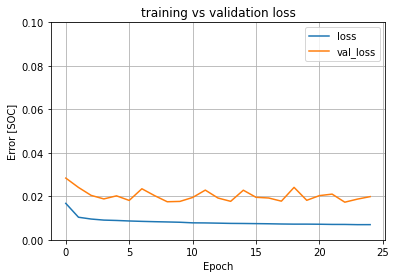

In [37]:
def plot_loss(history):
    plt.plot(history.history['loss'], label='loss')
    plt.plot(history.history['val_loss'], label='val_loss')
    plt.ylim([0, 0.1])
    plt.xlabel('Epoch') 
    plt.ylabel('Error [SOC]')
    plt.title('training vs validation loss')
    plt.legend()
    plt.grid(True)
    
plot_loss(history)

3266/3266 - 10s - loss: 0.0222 - mse: 8.0203e-04 - mae: 0.0222 - mape: 426.2714 - rmse: 0.0283 - 10s/epoch - 3ms/step
3266/3266 [==============================] - 8s 3ms/step


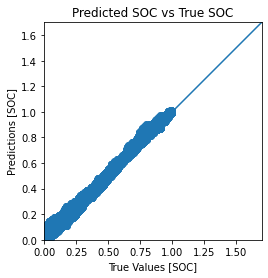

In [7]:
test_results = dnn_model.evaluate(test_features, test_labels, verbose=2)
test_predictions = dnn_model.predict(test_features).flatten()

a = plt.axes(aspect='equal')
plt.scatter(test_labels, test_predictions)
plt.xlabel('True Values [SOC]')
plt.ylabel('Predictions [SOC]')
lims = [0, 1.7]
plt.xlim(lims)
plt.ylim(lims)
plt.title('Predicted SOC vs True SOC')
_ = plt.plot(lims, lims)

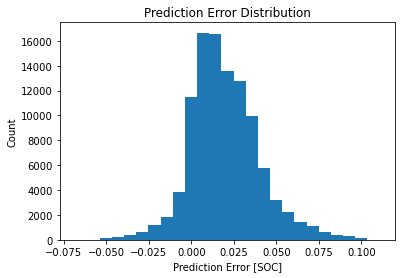

In [41]:
error = test_predictions - test_labels
plt.hist(error, bins=25)
plt.xlabel('Prediction Error [SOC]')
plt.title('Prediction Error Distribution')
_ = plt.ylabel('Count')

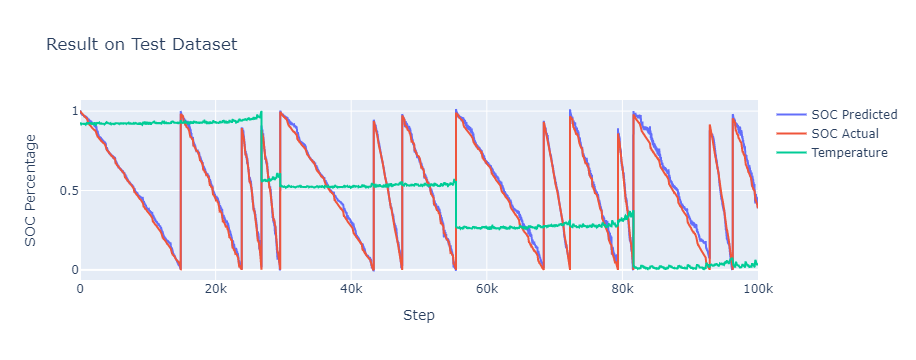

In [8]:
import plotly.graph_objects as go

cycle_num = 0
steps_num = 100000
step_index = np.arange(cycle_num*steps_num, (cycle_num+1)*steps_num)

fig = go.Figure()
fig.add_trace(go.Scatter(x=step_index, y=test_predictions[cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='SOC Predicted'))
fig.add_trace(go.Scatter(x=step_index, y=test_labels[cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='SOC Actual'))
fig.add_trace(go.Scatter(x=step_index, y=lg_test_norm['Temperature'][cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='Temperature'))
fig.update_layout(title='Result on Test Dataset',
                  xaxis_title='Step',
                  yaxis_title='SOC Percentage')
fig.show()